<a href="https://colab.research.google.com/github/onoderayuuki/pointcloud/blob/main/20230423.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
!pip install open3d

import sys
import numpy as np
import pandas as pd
import open3d as o3d

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/


In [ ]:
!pip install trimesh
import trimesh
import numpy as np
from shapely.geometry import LineString
%pylab inline
%config InlineBackend.figure_format = 'svg'
# http://3dcad.garyoutensei.com/6-2_CloudCompare.html#CC7
# https://stackoverflow.com/questions/60038105/find-what-is-material-and-what-is-air-in-2d-cross-sections-from-3d-stl-files-us


Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Populating the interactive namespace from numpy and matplotlib


/usr/local/lib/python3.9/dist-packages/IPython/core/magics/pylab.py:159: UserWarning:

pylab import has clobbered these variables: ['cm']
`%matplotlib` prevents importing * from pylab and numpy



In [ ]:
from sklearn.cluster import KMeans

In [ ]:
from scipy.spatial.distance import pdist, squareform

In [ ]:
filename = '/content/drive/MyDrive/PointCloudData/point_cloud3.ply'
pcd_doki = o3d.io.read_point_cloud(filename)

## ダウンサンプリングして表示
pcd_doki_down = pcd_doki.uniform_down_sample(every_k_points=10)
o3d.visualization.draw_plotly([pcd_doki_down])

## 座標とRGBを配列化
np_doki = np.asarray(pcd_doki.points)
np_col = np.asarray(pcd_doki.colors) #* 255.0


In [ ]:
xyz = ['x','y','z']
rgb = ['r','g','b']
rgb2 = ['r2','g2','b2']

## xyzrgb　の並びにする
df1 = pd.DataFrame(data=np_doki, columns=xyz)
df2 = pd.DataFrame(np_col, columns=rgb)
df_pcd = pd.concat([df1, df2], axis=1)

df_pcd['border'] = df_pcd['r']+0.1
df_pcd['type'] = 'normal'

# 緑：口縁
green_rows = df_pcd.query('g > border & g > b & g >0.1 & z > 0')
green_rows['type'] = 'green' 

# 青：底部
blue_rows = df_pcd.query('b > border & b > g & b >0.1 & z < 0')
blue_rows['type'] = 'blue'

## 元dataframe
df_pcd.update(green_rows)
df_pcd.update(blue_rows)

# 口縁
pcd_doki2 = o3d.geometry.PointCloud()
pcd_doki2.points = o3d.utility.Vector3dVector(green_rows[xyz].values)
pcd_doki2.colors = o3d.utility.Vector3dVector(green_rows[rgb].values)
o3d.visualization.draw_plotly([pcd_doki2])

# 底部
pcd_doki3 = o3d.geometry.PointCloud()
pcd_doki3.points = o3d.utility.Vector3dVector(blue_rows[xyz].values)
pcd_doki3.colors = o3d.utility.Vector3dVector(blue_rows[rgb].values)
o3d.visualization.draw_plotly([pcd_doki3])


<ipython-input-179-465d5c1585fa>:15: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

<ipython-input-179-465d5c1585fa>:19: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy



In [ ]:
# 3点を抽出
X = green_rows[xyz].values
kmeans = KMeans(n_clusters=3, random_state=9).fit(X)
 #green_rows['result'] = kmeans.labels_ 
#df_centers = pd.DataFrame(data=kmeans.cluster_centers_, columns=xyz)
print(kmeans.cluster_centers_)

[[ 0.02124662  0.09449792  0.12582933]
 [ 0.03558159 -0.08031279  0.15625259]
 [ 0.02074483  0.00973047  0.13759057]]


/usr/local/lib/python3.9/dist-packages/sklearn/cluster/_kmeans.py:870: FutureWarning:

The default value of `n_init` will change from 10 to 'auto' in 1.4. Set the value of `n_init` explicitly to suppress the warning



In [ ]:
# 3次元空間の3点を示すNumpy配列を生成
# points = np.array([[0.54242358, 0.94373941, 0.03549607],
#                    [0.92990328, 0.85805119, 0.23877127],
#                    [0.16066227, 0.62000717, 0.70497215]])

points = kmeans.cluster_centers_

# 2点間の距離を計算
distances = pdist(points)

# 距離行列を作成
distance_matrix = squareform(distances)

# 最も距離が大きい2点を探す
i, j = np.unravel_index(np.argmax(distance_matrix), distance_matrix.shape)

# 残りの1点のインデックスを取得
k = np.setdiff1d(np.arange(3), [i, j])[0]

# 距離を取得
distances = distance_matrix[i, j]

# 中心を計算
#point_center,radius  = find_circle_center(points[0], points[1], points[2])
# radius  = calculate_circle_radius(points)
# 平面上にある最短距離の点の座標を求める
#point_center = find_closest_point_on_plane(points)
# point_on_plane と point1 の距離を計算
#radius = np.linalg.norm(closest_point_on_plane - points[0])


# 結果を出力
point_i = points[i]
point_j = points[j]
point_k = points[k]

print(f"最も距離が大きい2点の座標: {point_i}, {point_j}")
print("距離:", distances)
print(f"残りの1点の座標: {point_k}")
#print(f"中心座標: {point_center}")
#print(f"半径: {radius}")
#print(point_center2,radius2)

最も距離が大きい2点の座標: [0.02124662 0.09449792 0.12582933], [ 0.03558159 -0.08031279  0.15625259]
距離: 0.1780164317732562
残りの1点の座標: [0.02074483 0.00973047 0.13759057]


In [ ]:
def dog_axis(right_eye, left_eye, nose ,zzz):
    origin = (right_eye + left_eye) / 2
    #原点を両目の中点とする
    px = right_eye - left_eye
    # x軸は左目→右目
    py = nose - origin
    # 「しっぽから鼻にむかう直線」

    """それぞれの単位ベクトルを計算"""
    ex = px / np.linalg.norm(px)
    ez = np.cross(px, py) / np.linalg.norm(np.cross(px, py))
    ey = np.cross(ez, ex)

    """変換行列 4x4 を作成"""
    #ローカル座標（犬から見た座標）を絶対座標に変換する行列
    R_LtoG = np.identity(4)

    R_LtoG[:3, :3] = np.array([ex, ey, ez]).T
    #回転行列を代入
    R_LtoG[:3, 3] = origin
    #移動ベクトルを代入

    #絶対座標からローカル座標（犬からみた座標）に変換する行列
    R_GtoL = np.identity(4)*zzz
    R_GtoL[:3, :3] = np.array([ex, ey, ez])
    R_GtoL[:3, 3] = - np.dot(np.array([ex, ey, ez]), origin)

    return (R_GtoL, R_LtoG)

In [ ]:
R_GtoL, R_LtoG = dog_axis(point_i, point_j, point_k,1)

# 元の点群から青と緑を引いて位置移動
df_pcd_normal = df_pcd[df_pcd['type'] == 'normal']


pcd_normal = o3d.geometry.PointCloud()
pcd_normal.points = o3d.utility.Vector3dVector(df_pcd_normal[xyz].values)
pcd_normal.colors = o3d.utility.Vector3dVector(df_pcd_normal[rgb].values)

pcd_moved = pcd_normal.transform(R_GtoL)


## ダウンサンプリングして表示
pcd_doki_down2 = pcd_moved.uniform_down_sample(every_k_points=10)
o3d.visualization.draw_plotly([pcd_doki_down2])

In [ ]:
def calculate_circle(points):
    """
    3つの点を通る円の中心座標と半径を計算する関数

    Parameters
    ----------
    points : array-like, shape (3, 2)
        3つのXY座標を持つNumPy配列

    Returns
    -------
    float, float, float
        円の中心座標のX座標、Y座標、半径
    """

    # 各点の座標を変数に代入
    x1, y1 = points[0]
    x2, y2 = points[1]
    x3, y3 = points[2]

    # 3点を通る円の中心座標を計算
    D = 2 * (x1 * (y2 - y3) + x2 * (y3 - y1) + x3 * (y1 - y2))
    Ux = ((x1 ** 2 + y1 ** 2) * (y2 - y3) + (x2 ** 2 + y2 ** 2) * (y3 - y1) + (x3 ** 2 + y3 ** 2) * (y1 - y2)) / D
    Uy = ((x1 ** 2 + y1 ** 2) * (x3 - x2) + (x2 ** 2 + y2 ** 2) * (x1 - x3) + (x3 ** 2 + y3 ** 2) * (x2 - x1)) / D

    # 3点を通る円の半径を計算
    R = np.sqrt((x1 - Ux) ** 2 + (y1 - Uy) ** 2)

    return Ux, Uy, R

[-0.0, -0.4931608841075222]
0.5011288458161569


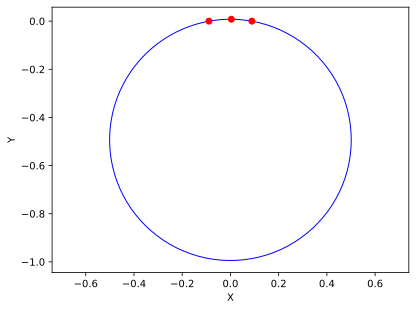

In [ ]:
pcd_z = o3d.geometry.PointCloud()
pcd_z.points = o3d.utility.Vector3dVector(points)
pcd_z_moved = pcd_z.transform(R_GtoL)
np_z = np.asarray(pcd_z_moved.points)

# np_z[:, 2] = 0
# print(np_z)

# center,radius = calculate_circle_radius(np_z)
# print(center,radius)

cx, cy, radius = calculate_circle(np_z[:, :2])

# 角度を0から360度まで0.1刻みで生成
theta = np.linspace(0, 2 * np.pi, 100)

# 円のx, y座標を計算
x = radius * np.cos(theta) + cx
y = radius * np.sin(theta) + cy

# 円を描画
plt.plot(x, y, 'b-', linewidth=1)  # 線の色を青、線幅を2に設定

# X座標を取得
xx = np_z[:, 0]
# Y座標を取得
yy = np_z[:, 1]
plt.plot(xx,yy , 'ro')  # 赤色の点をプロット

plt.axis('equal')  # X軸とY軸のスケールを等しく設定
plt.xlabel('X')  # X軸のラベルを設定
plt.ylabel('Y')  # Y軸のラベルを設定

print([cx,cy])
print(radius)
plt.show()  # グラフを表示

In [ ]:
def move_points_to_origin(points, origin):
    """
    点群データを指定された原点に移動する関数

    Parameters
    ----------
    points : numpy.ndarray, shape (N, 3)
        3次元の点群データを表すnumpy配列
    origin : numpy.ndarray, shape (3,)
        移動先の原点としたい任意の点の座標を表すnumpy配列

    Returns
    -------
    moved_points : numpy.ndarray, shape (N, 3)
        移動後の点群データを表すnumpy配列
    """
    # 移動前の点群データの重心を計算
    centroid = np.mean(points, axis=0)

    # 移動先の原点としたい任意の点と重心との差を計算
    translation = origin - centroid

    # 点群データを移動
    moved_points = points + translation

    return moved_points


In [ ]:
translation = np.array([0,0,0]) - np.array([0,cy,0])
moved_points = np.asarray(pcd_moved.points) - np.array([0,cy,0])


pcd_moved_points = o3d.geometry.PointCloud()
pcd_moved_points.points = o3d.utility.Vector3dVector(moved_points)
pcd_moved_points.colors = o3d.utility.Vector3dVector(pcd_moved.colors)

## ダウンサンプリングして表示
pcd_doki_down3 = pcd_moved_points.uniform_down_sample(every_k_points=10)
o3d.visualization.draw_plotly([pcd_doki_down3])

In [ ]:
# メッシュ化

# 法線推定
pcd_doki_down3.estimate_normals()

# 法線推定調整時の半径が重要！土器の最薄の厚みを考えないと
pcd_doki_down3.orient_normals_consistent_tangent_plane(10)

# ポアソン曲面
with o3d.utility.VerbosityContextManager(
        o3d.utility.VerbosityLevel.Debug) as cm:
    mesh_doki, densities = o3d.geometry.TriangleMesh.create_from_point_cloud_poisson(pcd_doki_down3, depth=10)
#ダウンサンプリングしたものしか処理できないけど計算資源あればいけるかも

o3d.visualization.draw_plotly([mesh_doki])

[Open3D DEBUG] Input Points / Samples: 53193 / 52830
[Open3D DEBUG] #   Got kernel density: 0.1551659107208252 (s), 854.13671875 (MB) / 854.13671875 (MB) / 1068 (MB)
[Open3D DEBUG] #     Got normal field: 0.17465901374816895 (s), 854.13671875 (MB) / 854.13671875 (MB) / 1068 (MB)
[Open3D DEBUG] Point weight / Estimated Area: 3.520110e-05 / 1.872452e+00
[Open3D DEBUG] #       Finalized tree: 0.31990885734558105 (s), 854.13671875 (MB) / 854.13671875 (MB) / 1068 (MB)
[Open3D DEBUG] #  Set FEM constraints: 1.3070330619812012 (s), 854.13671875 (MB) / 854.13671875 (MB) / 1068 (MB)
[Open3D DEBUG] #Set point constraints: 0.12828302383422852 (s), 854.13671875 (MB) / 854.13671875 (MB) / 1068 (MB)
[Open3D DEBUG] Leaf Nodes / Active Nodes / Ghost Nodes: 1329651 / 756080 / 763521
[Open3D DEBUG] Memory Usage: 854.137 MB
[Open3D DEBUG] # Linear system solved: 1.2722840309143066 (s), 854.13671875 (MB) / 854.13671875 (MB) / 1068 (MB)
[Open3D DEBUG] Got average: 0.08748197555541992 (s), 854.13671875 (MB)

In [ ]:
import matplotlib.pyplot as plt
def path2Dshow(Path2D,filename):
        if Path2D.is_closed:
              plt.cla()
              axis = plt.gca()
              axis.set_aspect('equal', 'datalim')

              for i, points in enumerate(Path2D.discrete):
                  # 転置が必要
                  # axis.plot(*points.T, color=(0,0,1))
                  axis.plot(*points[:, ::-1].T, color=(0,0,1), alpha = 0.4)
              
              plt.hlines(0,-radius,radius,color="blue", alpha = 0.4)
              plt.vlines(0,-radius,0,color="blue", alpha = 0.4)

              # 目盛線を設定
              axis.grid(which = "major", axis = "x", color = "green", alpha = 0.3, linewidth = 1)
              axis.grid(which = "major", axis = "y", color = "green", alpha = 0.3, linewidth = 1)
              
              # 補助目盛線を設定
              axis.minorticks_on()
              axis.grid(which = "minor", axis = "x", color = "green", alpha = 0.3, linestyle = "--", linewidth = 0.5)
              axis.grid(which = "minor", axis = "y", color = "green", alpha = 0.3, linestyle = "--", linewidth = 0.5)
              
              #plt.savefig(filename, format="png", dpi=300)
              plt.show()
              
              return axis
        else:
            return 'is_not_closed'

In [ ]:
# open3d.cpu.pybind.geometry.TriangleMesh を trimesh.base.Trimesh オブジェクトに変換
trimesh_doki = trimesh.Trimesh(vertices=np.asarray(mesh_doki.vertices),
                               faces=np.asarray(mesh_doki.triangles))

slice = trimesh_doki.section(plane_origin=(0,0,0),#mesh2.centroid,
                     plane_normal=[1,0,0])

to_2D = trimesh.geometry.align_vectors([0,0,1], [1,0,0])

slice_2D, to_3D = slice.to_planar(to_2D = to_2D)
# slice_2D, to_3D = slice.to_planar()

# print(slice_2D)
filename = '/content/drive/MyDrive/PointCloudData/cross2.png'
# path2Dshow(slice_2D,filename)

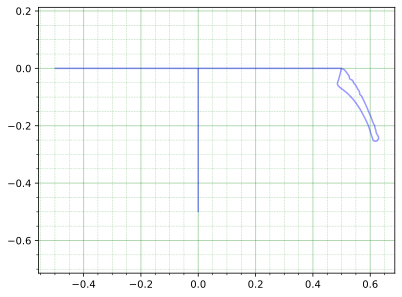

0.5011288458161569


In [ ]:
path2Dshow(slice_2D,filename)

print(radius)

In [ ]:
# def find_circle_center(p1, p2, p3):
#     # 3つの点の座標を取得
#     x1, y1, z1 = p1
#     x2, y2, z2 = p2
#     x3, y3, z3 = p3

#     # 3つの点を含む平面を定義
#     normal = np.cross(p2 - p1, p3 - p1)
    
#     # 平面の法線ベクトルを正規化
#     normal = normal / np.linalg.norm(normal)

#     # 3つの点の中点を計算
#     mid = (p1 + p2 + p3) / 3

#     # 中点から平面の法線ベクトルに垂直なベクトルを求める
#     perpendicular = np.cross(mid - p1, normal)

#     # 円の中心を計算
#     center = mid + perpendicular

#     # 各点から中心座標への距離を計算し、最大値を円周の半径とする
#     distances = np.linalg.norm(points - center, axis=1)
#     radius = np.max(distances)

#     return center,radius

In [ ]:
# def calculate_circle_radius(points):
#     """
#     ３点の３次元座標を使って、それを通る円周の半径を計算する関数

#     Parameters
#     ----------
#     points : numpy array, shape (3, 3)
#         ３点の３次元座標

#     Returns
#     -------
#     float
#         円周の半径
#     """
#     # 平面の法線ベクトルを求める
#     v1 = points[1] - points[0]
#     v2 = points[2] - points[0]
#     normal = np.cross(v1, v2)

#     # ３点の中心座標を求める
#     center = np.mean(points, axis=0)

#     # 各点から中心座標への距離を計算し、最大値を円周の半径とする
#     distances = np.linalg.norm(points - center, axis=1)
#     radius = np.max(distances)

#     return center,radius

In [ ]:
# def generate_circle_point_cloud(points):
#     """
#     ３点の３次元座標を使って、それを通る同一平面上の円の点群を生成する関数

#     Parameters
#     ----------
#     points : numpy array, shape (3, 3)
#         ３点の３次元座標

#     Returns
#     -------
#     o3d.geometry.PointCloud
#         生成された円の点群
#     """
#     # 3点を通る平面の法線ベクトルを計算
#     v1 = points[1] - points[0]
#     v2 = points[2] - points[0]
#     normal = np.cross(v1, v2)

#     # 3点が同一平面上にあるかを判定
#     if np.linalg.norm(normal) == 0:
#         raise ValueError("Input points are not on the same plane.")

#     # 平面の方程式 Ax + By + Cz + D = 0 の係数を計算
#     A, B, C = normal
#     D = -np.dot(normal, points[0])

#     # 平面に垂直なベクトルを計算
#     if A != 0:
#         v = np.array([(-D-B)/A, 1, 0])
#     elif B != 0:
#         v = np.array([1, (-D-A)/B, 0])
#     else:
#         v = np.array([1, 0, (-D-A)/C])

#     # 平面に垂直なベクトルと法線ベクトルの外積を計算し、円の法線ベクトルを得る
#     circle_normal = np.cross(v, normal)

#     # 3点を通る円の中心座標を計算
#     center = np.mean(points, axis=0)

#     # 円上の点を生成
#     theta = np.linspace(0, 2 * np.pi, 100)
#     x = center[0] + np.cos(theta) * circle_normal[0]
#     y = center[1] + np.cos(theta) * circle_normal[1]
#     z = center[2] + np.cos(theta) * circle_normal[2]
#     points = np.vstack((x, y, z)).T

#     # 点群を生成
#     point_cloud = o3d.geometry.PointCloud()
#     point_cloud.points = o3d.utility.Vector3dVector(points)

#     return point_cloud

In [ ]:
# def generate_sphere_point_cloud(points):
#     """
#     ３点を表面に持つ球の点群を生成する関数

#     Parameters
#     ----------
#     points : numpy array, shape (3, 3)
#         ３点の３次元座標

#     Returns
#     -------
#     o3d.geometry.PointCloud
#         生成された球の点群
#     """
#     # 3点の座標を取得
#     point1 = points[0]
#     point2 = points[1]
#     point3 = points[2]

#     # 3点を通る球の中心座標を計算
#     # 3点を結ぶベクトルとその垂直二つを計算
#     v1 = point2 - point1
#     v2 = point3 - point1
#     normal = np.cross(v1, v2)
#     d = -np.dot(normal, point1)
#     center = -normal * d

#     # 3点間の距離を計算して最大のものを半径とする
#     radius = max(np.linalg.norm(point1 - center),
#                 np.linalg.norm(point2 - center),
#                 np.linalg.norm(point3 - center))

#     # 球の表面の点群を生成
#     sphere = o3d.geometry.TriangleMesh.create_sphere(radius=radius)
#     sphere.translate(center)

#     # 3点を球の外側に持つように球の中心座標を調整
#     for i in range(3):
#         if np.dot(sphere.vertices[i], normal) > d:
#             sphere.vertices[i] = (sphere.vertices[i] - center) * radius / (radius + 1) + center

#     # 球の点群を点群データに変換
#     point_cloud = o3d.geometry.PointCloud()
#     point_cloud.points = o3d.utility.Vector3dVector(np.asarray(sphere.vertices))

#     return point_cloud

In [ ]:
# def find_closest_point_on_plane(points):
#     """
#     ３点を通る平面上にある最短距離の点の座標を求める関数

#     Parameters
#     ----------
#     points : numpy array, shape (3, 3)
#         ３点の３次元座標

#     Returns
#     -------
#     numpy array, shape (3,)
#         平面上にある最短距離の点の３次元座標
#     """
#     # 3点の座標を取得
#     point1 = points[0]
#     point2 = points[1]
#     point3 = points[2]

#     # 3点を通る平面の法線ベクトルを計算
#     normal = np.cross(point2 - point1, point3 - point1)
#     normal /= np.linalg.norm(normal)

#     # 平面の法線ベクトルに垂直な直線上にある最短距離の点を計算
#     # 3点の座標の平均を取り、法線ベクトルのスケール分だけ移動
#     center = np.mean(points, axis=0)
#     point_on_plane = center + normal

#     return point_on_plane

In [ ]:
# # 平面上にある最短距離の点の座標を求める
# closest_point_on_plane = find_closest_point_on_plane(points)
# # point_on_plane と point1 の距離を計算
# closest_point_distance = np.linalg.norm(closest_point_on_plane - points[0])
# print(closest_point_on_plane)
# print(closest_point_distance)

# sphere = o3d.geometry.TriangleMesh.create_sphere(radius=radius)
# sphere.translate(center)
# #point_cloud_sphere = generate_sphere_point_cloud(points)
# point_cloud_sphere = o3d.geometry.PointCloud()
# point_cloud_sphere.points = o3d.utility.Vector3dVector(np.asarray(sphere.vertices))
# point_cloud_sphere.paint_uniform_color([0, 1, 0])  # 赤色に設定


[ 0.39518118 -0.12188705 -0.7802922 ]
1.003845478829867


PointCloud with 762 points.

In [ ]:
# points2 = np.asarray(point_cloud_sphere.points)
# colors2 = np.asarray(point_cloud_sphere.colors)

# # 2つの点群データを連結
# points_combined = np.concatenate([np_z, points2], axis=0)
# points_combined_color = np.concatenate([np_z, colors2], axis=0)

# # 新しいPointCloudオブジェクトを作成
# point_cloud_combined = o3d.geometry.PointCloud()
# point_cloud_combined.points = o3d.utility.Vector3dVector(points_combined)
# point_cloud_combined.colors = o3d.utility.Vector3dVector(points_combined_color)

# # 融合された点群を表示
# o3d.visualization.draw_plotly([point_cloud_combined])

In [ ]:
##np_doki_down2 = np.asarray(pcd_doki_down2.points)

# 3列目で一番小さい値を取得
#min_value = np.max(np_doki_down2[:, 2])

#points_z0 = np_doki_down2[np_doki_down2[:, 2] == min_value]

#pcd_3 = o3d.geometry.PointCloud()
#pcd_3.points = o3d.utility.Vector3dVector(points_z0)

#print(points_z0)
#o3d.visualization.draw_plotly([pcd_3])